In [1]:
import matplotlib.pyplot as plt
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point, Polygon
import numpy as np
import geoplot


In [2]:
# Load cases_train.csv into dataframe

cases = pd.read_csv("../data/cases_train.csv")

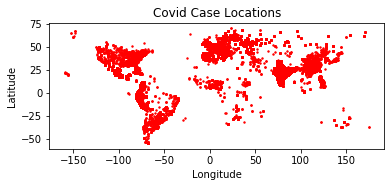

In [3]:
#COVID Case locations plot

#Create geodataframe
crs={'init':'epsg:4326'}
geometry=[Point(xy) for xy in zip(cases["longitude"], cases["latitude"])]
geodata=gpd.GeoDataFrame(cases,crs=crs, geometry=geometry)

#Plot geodataframe
fig, ax = plt.subplots()
geodata.plot(ax=ax, color='red', markersize=2)
ax.set_title('Covid Case Locations', fontsize=12)
ax.set_xlabel('Longitude', fontsize=10)
ax.set_ylabel('Latitude', fontsize='medium')

#save plot
plt.savefig('../plots/cases-locations_map.png')

date_confirmation
2020-01-06     2
2020-01-12     1
2020-01-15     2
2020-01-18     2
2020-01-19     1
              ..
2020-06-12    46
2020-06-13    50
2020-06-14     9
2020-06-15     3
2020-06-16     9
Length: 154, dtype: int64
date_confirmation
2020-01-06     2
2020-01-12     1
2020-01-15     2
2020-01-18     2
2020-01-19     1
              ..
2020-06-12    46
2020-06-13    50
2020-06-14     9
2020-06-15     3
2020-06-16     9
Length: 154, dtype: int64


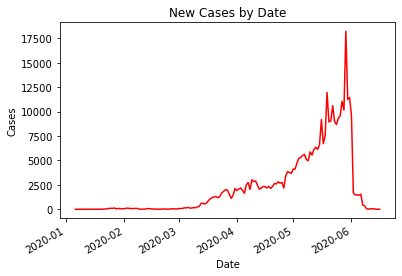

In [9]:
#Total new cases per day 

#Get cases per day
cases['date_confirmation'] = pd.to_datetime(cases['date_confirmation'], errors='coerce', dayfirst=True)
date_counts = cases.groupby(by=["date_confirmation"]).size()
print(date_counts)

#Plot cases_per_day
fig, ax = plt.subplots()
ax = date_counts.plot(x='Date', y='Cases', color='red')
fig.autofmt_xdate()
ax.set_title('New Cases by Date', fontsize=12)
ax.set_xlabel('Date', fontsize=10)
ax.set_ylabel('Cases', fontsize='medium')

#save plot
plt.savefig('../plots/cases-cases_by_date.png')


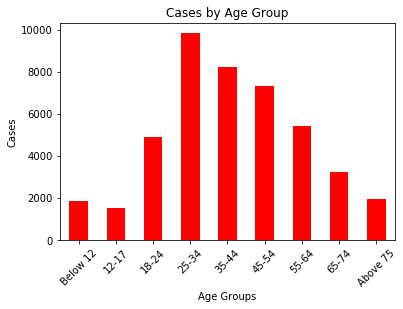

In [10]:
#Cases per age group

only_ints = cases[cases['age'].astype(str).str.isdigit()]
age_groups = pd.cut(only_ints.age.astype('int64'), bins=[0,11, 17, 24, 34, 44, 54, 64, 74, 99], labels=['Below 12','12-17','18-24','25-34', '35-44', '45-54', '55-64', '65-74', 'Above 75'])
only_ints.insert(5, "Age Group", age_groups)

age_counts = only_ints.groupby(by=["Age Group"]).size()
age_counts.columns = ['Age Group','Count']

#Plot cases_per_day
fig, ax = plt.subplots()
ax = age_counts.plot.bar(x='Age', y='Cases', color='red')
plt.xticks(rotation = 45) 
ax.set_title('Cases by Age Group', fontsize=12)
ax.set_xlabel('Age Groups', fontsize=10)
ax.set_ylabel('Cases', fontsize='medium')

#save plot
plt.savefig('../plots/cases-cases_by_age.png')

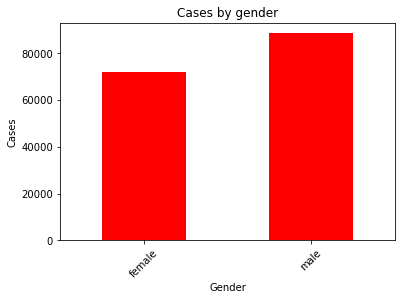

In [11]:
#Cases per gender

sex_counts = cases.groupby(by=["sex"]).size()
sex_counts

#Plot cases_per_day
fig, ax = plt.subplots()
ax = sex_counts.plot.bar(x='Sex', y='Cases', color='red')
plt.xticks(rotation = 45) 
ax.set_title('Cases by gender', fontsize=12)
ax.set_xlabel('Gender', fontsize=10)
ax.set_ylabel('Cases', fontsize='medium')

#save plot
plt.savefig('../plots/cases-cases_by_gender.png')

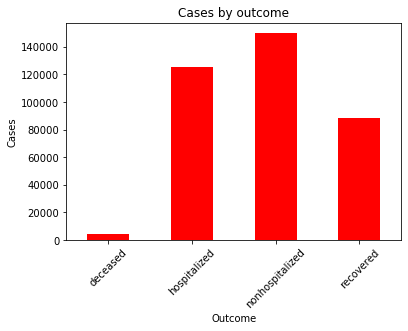

In [12]:
#Cases per Outcome

outcome_counts = cases.groupby(by=["outcome"]).size()

#Plot cases_per_day
fig, ax = plt.subplots()
ax = outcome_counts.plot.bar(x='Outcome', y='Cases', color='red')
plt.xticks(rotation = 45) 
ax.set_title('Cases by outcome', fontsize=12)
ax.set_xlabel('Outcome', fontsize=10)
ax.set_ylabel('Cases', fontsize='medium')

#save plot
plt.savefig('../plots/cases-cases_by_outcome.png')

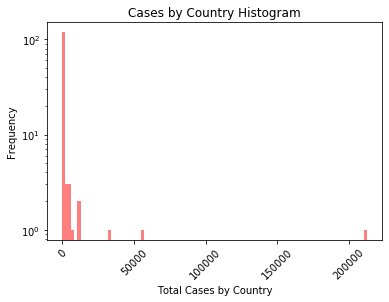

In [13]:
#Cases per Country over 1000 cases

country_counts = cases.groupby(by=["country"]).size()

#Plot cases_per_day
ax = country_counts.plot.hist(bins=100, alpha=0.5, color='red')
plt.xticks(rotation = 45) 
plt.yscale("log")
ax.set_title('Cases by Country Histogram', fontsize=12)
ax.set_xlabel('Total Cases by Country', fontsize=10)
ax.set_ylabel('Frequency', fontsize='medium')

#save plot
plt.savefig('../plots/cases-cases_by_country_hist.png')

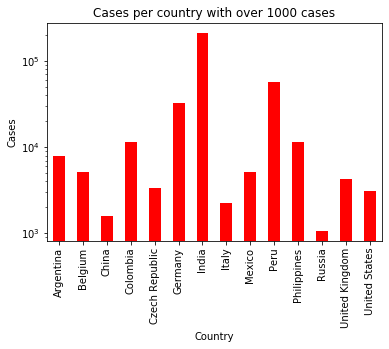

In [14]:
#Top country by cases

country_counts = cases.groupby(by=["country"]).size()
filter_small = country_counts[country_counts > 1000]

#Plot cases_per_day
fig, ax = plt.subplots()
ax = filter_small.plot.bar(x='Country', y='Cases', color='red')
plt.xticks(rotation = 90) 
plt.yscale("log")
ax.set_title('Cases per country with over 1000 cases', fontsize=12)
ax.set_xlabel('Country', fontsize=10)
ax.set_ylabel('Cases', fontsize='medium')

#save plot
plt.savefig('../plots/cases-top_countries_by_cases.png')

In [15]:
# For every attribute print the number of missing values
print("Missing value counts for cases_train.csv\n")

print("AGE: " + str(cases['age'].isnull().sum()))
print("SEX: " + str(cases['sex'].isnull().sum()))
print("PROVINCE: " + str(cases['province'].isnull().sum()))
print("COUNTRY: " + str(cases['country'].isnull().sum()))
print("LATITUDE: " + str(cases['latitude'].isnull().sum()))
print("DATE_CONFIRMATION: " + str(cases['date_confirmation'].isnull().sum()))
print("ADDITIONAL_INFORMATION: " + str(cases['additional_information'].isnull().sum()))
print("SOURCE: " + str(cases['source'].isnull().sum()))
print("GEOMETRY: " + str(cases['geometry'].isnull().sum()))

Missing value counts for cases_train.csv

AGE: 209265
SEX: 207084
PROVINCE: 4106
COUNTRY: 18
LATITUDE: 2
DATE_CONFIRMATION: 374
ADDITIONAL_INFORMATION: 344912
SOURCE: 128478
GEOMETRY: 0


In [16]:
# DATA EXPLORATION FOR LOCATION.CSV
#Load location.csv into dataframe

location = pd.read_csv("../data/location.csv")

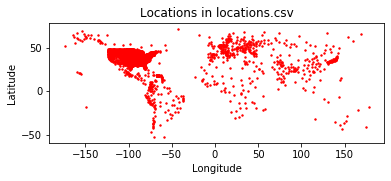

In [17]:
#COVID Case locations plot

#Create geodataframe
crs={'init':'epsg:4326'}
geometry=[Point(xy) for xy in zip(location["Long_"], location["Lat"])]
geodata=gpd.GeoDataFrame(location,crs=crs, geometry=geometry)

#Plot geodataframe
fig, ax = plt.subplots()
geodata.plot(ax=ax, color='red', markersize=2)
ax.set_title('Locations in locations.csv', fontsize=12)
ax.set_xlabel('Longitude', fontsize=10)
ax.set_ylabel('Latitude', fontsize='medium')

#save plot
plt.savefig('../plots/location-all_locations_map.png')

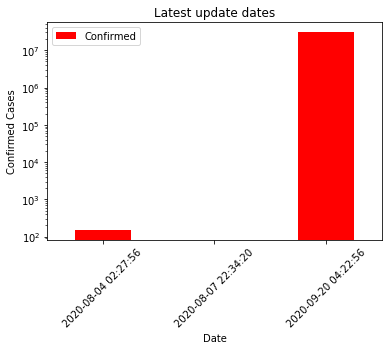

In [18]:
# Cases per last_updated date

last_update_counts = location.groupby(by=["Last_Update"]).sum()
filter = last_update_counts[['Confirmed']]

#Plot cases_per_day
ax = last_update_counts.plot.bar(y='Confirmed', color='red')
plt.xticks(rotation = 45) 
plt.yscale("log")
ax.set_title('Latest update dates', fontsize=12)
ax.set_xlabel('Date', fontsize=10)
ax.set_ylabel('Confirmed Cases', fontsize='medium')

#save plot
plt.savefig('../plots/location-confirmed_by_last_updated_date.png')

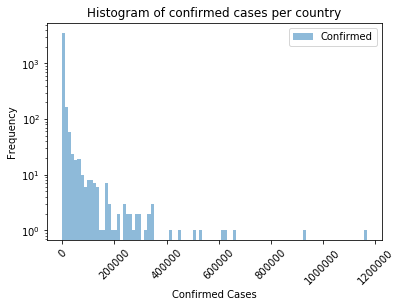

In [19]:
#Confirmed Hist

filter = location[['Confirmed']]

#Plot cases_per_day
ax = filter.plot.hist(bins=100, alpha=0.5)
plt.xticks(rotation = 45) 
plt.yscale("log")
ax.set_title('Histogram of confirmed cases per country', fontsize=12)
ax.set_xlabel('Confirmed Cases', fontsize=10)
ax.set_ylabel('Frequency', fontsize='medium')

#save plot
plt.savefig('../plots/location-confirmed_hist.png')

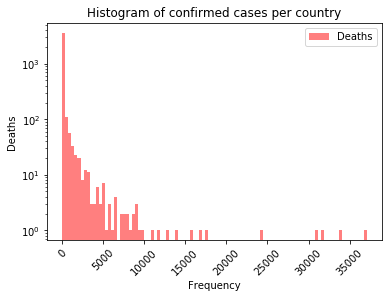

In [20]:
# Deaths Hist

filter = location[['Deaths']]

#Plot cases_per_day
ax = filter.plot.hist(bins=100, alpha=0.5, color='red')
plt.xticks(rotation = 45) 
plt.yscale("log")
ax.set_title('Histogram of confirmed cases per country', fontsize=12)
ax.set_xlabel('Frequency', fontsize=10)
ax.set_ylabel('Deaths', fontsize='medium')

#save plot
plt.savefig('../plots/location-deaths_hist.png')

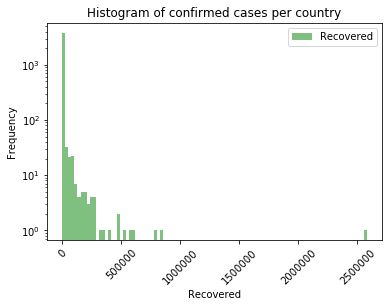

In [21]:
#Recovered Hist

filter = location[['Recovered']]

#Plot cases_per_day
ax = filter.plot.hist(bins=100, alpha=0.5, color='green')
plt.xticks(rotation = 45) 
plt.yscale("log")
ax.set_title('Histogram of confirmed cases per country', fontsize=12)
ax.set_xlabel('Recovered', fontsize=10)
ax.set_ylabel('Frequency', fontsize='medium')

#save plot
plt.savefig('../plots/location-recovered_hist.png')

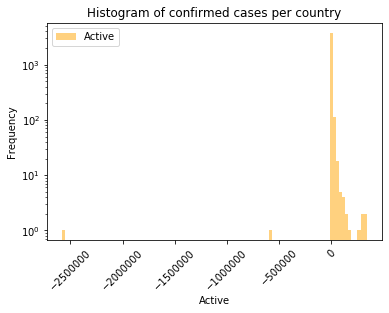

In [22]:
#Active Cases Hist

filter = location[['Active']]

#Plot cases_per_day
ax = filter.plot.hist(bins=100, alpha=0.5, color='orange')
plt.xticks(rotation = 45) 
plt.yscale("log")
ax.set_title('Histogram of confirmed cases per country', fontsize=12)
ax.set_xlabel('Active', fontsize=10)
ax.set_ylabel('Frequency', fontsize='medium')

#save plot
plt.savefig('../plots/location-active_hist.png')

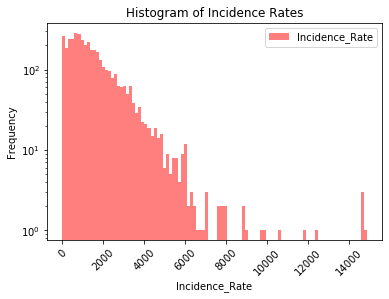

In [23]:
#Incidence Rate Hist

filter = location[['Incidence_Rate']]

#Plot cases_per_day
ax = filter.plot.hist(bins=100, alpha=0.5, color='red')
plt.xticks(rotation = 45) 
plt.yscale("log")
ax.set_title('Histogram of Incidence Rates', fontsize=12)
ax.set_xlabel('Incidence_Rate', fontsize=10)
ax.set_ylabel('Frequency', fontsize='medium')

#save plot
plt.savefig('../plots/location-incidence_rate_hist.png')

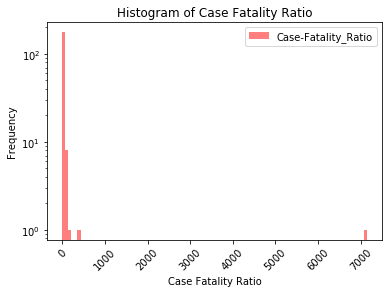

In [24]:
#Case-Fatality Ratio Hist

country_counts = location.groupby(by=["Country_Region"]).sum()
filter = country_counts[['Case-Fatality_Ratio']]

#Plot cases_per_day
ax = filter.plot.hist(bins=100, alpha=0.5, color='red')
plt.xticks(rotation = 45) 
plt.yscale("log")
ax.set_title('Histogram of Case Fatality Ratio', fontsize=12)
ax.set_xlabel('Case Fatality Ratio', fontsize=10)
ax.set_ylabel('Frequency', fontsize='medium')

#save plot
plt.savefig('../plots/location-case_fatality_ratio_hist.png')

In [25]:
# For every attribute print the number of missing values
print("Missing value counts for location.csv\n")

print("Province_State: " + str(location['Province_State'].isnull().sum()))
print("Country_Region: " + str(location['Country_Region'].isnull().sum()))
print("Last_Update: " + str(location['Last_Update'].isnull().sum()))
print("Lat: " + str(location['Lat'].isnull().sum()))
print("Long_: " + str(location['Long_'].isnull().sum()))
print("Confirmed: " + str(location['Confirmed'].isnull().sum()))
print("Deaths: " + str(location['Deaths'].isnull().sum()))
print("Recovered: " + str(location['Recovered'].isnull().sum()))
print("Active: " + str(location['Active'].isnull().sum()))
print("Combined_Key: " + str(location['Combined_Key'].isnull().sum()))
print("Incidence_Rate: " + str(location['Incidence_Rate'].isnull().sum()))
print("Case-Fatality_Ratio: " + str(location['Case-Fatality_Ratio'].isnull().sum()))


Missing value counts for location.csv

Province_State: 168
Country_Region: 0
Last_Update: 0
Lat: 80
Long_: 80
Confirmed: 0
Deaths: 0
Recovered: 0
Active: 2
Combined_Key: 0
Incidence_Rate: 80
Case-Fatality_Ratio: 48
